In [2]:
import pandas as pd
import datetime
import csv
import numpy as np
import os
import scipy as sp
import xgboost as xgb
import lightgbm as lgb
import itertools
import operator
import math
import warnings
warnings.filterwarnings("ignore")
from scipy import stats 
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.base import TransformerMixin
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error 
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import StratifiedKFold
from xgboost.sklearn import XGBRegressor
from lightgbm.sklearn import LGBMRegressor
from sklearn.externals import joblib
from xgboost import plot_importance

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
%config ZMQInteractiveShell.ast_node_interactivity='all'
%pprint

# 大小设置
sns.set(rc={'figure.figsize':(13,7)})
# 风格设置
sns.set_style("whitegrid")


Pretty printing has been turned OFF


# 数据导入并合并

## 加载数据

In [12]:
df_train = pd.read_table('../data/zhengqi_train.txt', sep='\t')
df_train.head(2)

,V0,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V29,V30,V31,V32,V33,V34,V35,V36,V37,target
0,0.566,0.016,-0.143,0.407,0.452,-0.901,-1.812,-2.36,-0.436,-2.114,...,0.136,0.109,-0.615,0.327,-4.627,-4.789,-5.101,-2.608,-3.508,0.175
1,0.968,0.437,0.066,0.566,0.194,-0.893,-1.566,-2.36,0.332,-2.114,...,-0.128,0.124,0.032,0.600,-0.843,0.160,0.364,-0.335,-0.730,0.676


In [13]:
df_test = pd.read_table('../data/zhengqi_test.txt', sep='\t')
df_test.head(2)

,V0,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37
0,0.368,0.380,-0.225,-0.049,0.379,0.092,0.550,0.551,0.244,0.904,...,-0.449,0.047,0.057,-0.042,0.847,0.534,-0.009,-0.190,-0.567,0.388
1,0.148,0.489,-0.247,-0.049,0.122,-0.201,0.487,0.493,-0.127,0.904,...,-0.443,0.047,0.560,0.176,0.551,0.046,-0.220,0.008,-0.294,0.104


## 合并

In [14]:
df_test["target"] = 0
df_train["isTrain"] = 1
df_test["isTrain"] = 0
dt = pd.concat([df_train, df_test], ignore_index=True)

# 数据探索

## 数据没有缺失

In [15]:
dt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4813 entries, 0 to 4812
Data columns (total 40 columns):
V0         4813 non-null float64
V1         4813 non-null float64
V2         4813 non-null float64
V3         4813 non-null float64
V4         4813 non-null float64
V5         4813 non-null float64
V6         4813 non-null float64
V7         4813 non-null float64
V8         4813 non-null float64
V9         4813 non-null float64
V10        4813 non-null float64
V11        4813 non-null float64
V12        4813 non-null float64
V13        4813 non-null float64
V14        4813 non-null float64
V15        4813 non-null float64
V16        4813 non-null float64
V17        4813 non-null float64
V18        4813 non-null float64
V19        4813 non-null float64
V20        4813 non-null float64
V21        4813 non-null float64
V22        4813 non-null float64
V23        4813 non-null float64
V24        4813 non-null float64
V25        4813 non-null float64
V26        4813 non-null float64
V2

## 数据整体分布

In [16]:
dt.describe()

,V0,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V30,V31,V32,V33,V34,V35,V36,V37,target,isTrain
count,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,...,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000
mean,0.000080,0.000082,-0.000043,-0.000013,0.000085,0.000023,0.000118,0.000116,0.000049,0.000357,...,0.000006,-0.000004,0.000173,0.000108,0.000036,-0.000079,-0.000110,0.000083,0.075817,0.600042
std,1.000013,1.000016,1.000007,0.999995,1.000015,0.999996,1.000035,1.000030,0.999994,1.000257,...,0.999993,0.999999,1.000077,1.000068,0.999998,1.000062,1.000019,1.000017,0.764660,0.489940
min,-4.814000,-5.488000,-4.283000,-3.956000,-4.921000,-2.182000,-5.649000,-5.625000,-6.059000,-12.891000,...,-4.507000,-7.698000,-4.057000,-4.627000,-4.789000,-7.477000,-2.608000,-3.630000,-3.044000,0.000000
25%,-0.468000,-0.319000,-0.625000,-0.651000,-0.428000,-0.583000,-0.494000,-0.368000,-0.429000,-0.390000,...,-0.301000,-0.300000,-0.428000,-0.499000,-0.290000,-0.349000,-0.485000,-0.666000,0.000000,0.000000
50%,0.245000,0.237000,0.105000,0.073000,0.114000,-0.133000,0.191000,0.198000,0.231000,0.042000,...,0.038000,0.217000,0.092000,-0.040000,0.160000,0.364000,0.115000,-0.043000,0.000000,1.000000
75%,0.666000,0.595000,0.698000,0.704000,0.576000,0.284000,0.705000,0.684000,0.637000,0.904000,...,0.469000,0.578000,0.587000,0.419000,0.273000,0.364000,0.647000,0.647000,0.460000,1.000000
max,2.121000,2.120000,2.828000,2.603000,4.475000,3.176000,1.895000,1.918000,2.408000,1.766000,...,3.139000,2.013000,2.395000,5.465000,5.110000,2.324000,5.238000,3.021000,2.538000,1.000000


## 相关分布

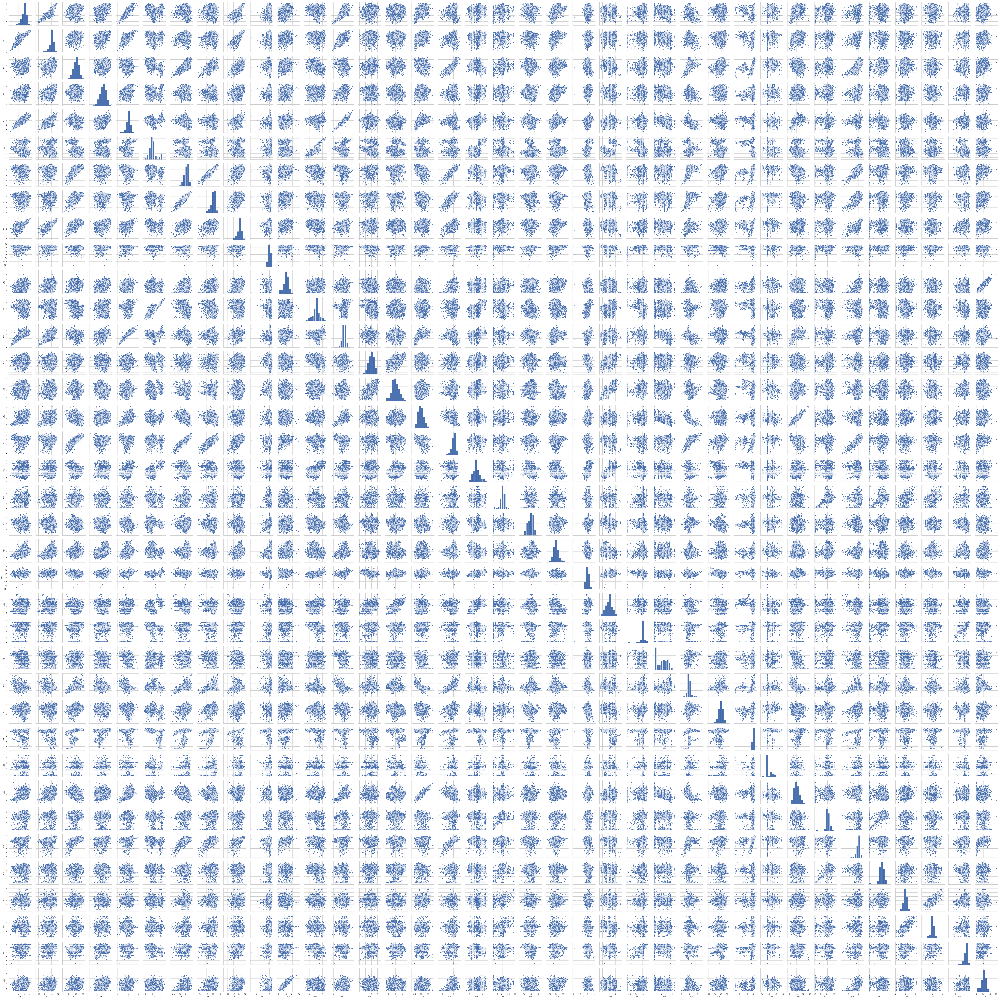

In [17]:
sns.pairplot(data=dt.iloc[:, 0:37])

## 蒸汽量分布

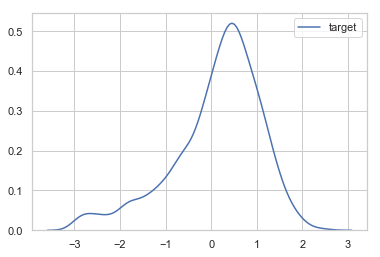

In [20]:
sns.kdeplot(dt.loc[dt.isTrain==1, 'target'])